### Initialization Bock

In [1]:
# Initialization
colab_run=False
anc_box= False
train=True
if colab_run==True:
  !pip install pydrive
  from pydrive.auth import GoogleAuth
  from pydrive.drive import GoogleDrive
  from google.colab import auth
  from oauth2client.client import GoogleCredentials

  auth.authenticate_user()
  gauth = GoogleAuth()
  gauth.credentials = GoogleCredentials.get_application_default()
  drive = GoogleDrive(gauth)

  import os, cv2
  from google.colab import drive
  drive.mount('/content/drive/')


from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Reshape, Activation, Conv2D, Input, MaxPooling2D, BatchNormalization, Flatten, Dense, Lambda
from tensorflow.keras.layers import LeakyReLU
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, TensorBoard
from tensorflow.keras.optimizers import SGD, Adam, RMSprop
from tensorflow.keras.layers import concatenate
from matplotlib import pyplot as plt
import tensorflow.keras.backend as K
import tensorflow as tf
import numpy as np
import pickle
import os, cv2

#os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"
#os.environ["CUDA_VISIBLE_DEVICES"] = ""

# %matplotlib inline


C:\Users\irfan\Anaconda3\envs\tf\lib\site-packages\tensorflow\python\framework\dtypes.py:523: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
C:\Users\irfan\Anaconda3\envs\tf\lib\site-packages\tensorflow\python\framework\dtypes.py:524: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
C:\Users\irfan\Anaconda3\envs\tf\lib\site-packages\tensorflow\python\framework\dtypes.py:525: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
C:\Users\irfan\Anaconda3\envs\tf\lib\site-packages\tensorflow\python\framework\dty

### Configure Block

### Model Building Block

In [2]:
LABELS=['person', 'bird', 'cat', 'cow', 'dog', 'horse', 'sheep','aeroplane', 'bicycle',
         'boat', 'bus', 'car', 'motorbike', 'train', 'bottle', 'chair','dining table',
         'potted plant', 'sofa', 'tvmonitor']

IMAGE_H, IMAGE_W = 416, 416
GRID_H,  GRID_W  = 13 , 13 
BOX              = 5
CLASS            = len(LABELS)
CLASS_WEIGHTS    = np.ones(CLASS, dtype='float32')
OBJ_THRESHOLD    = 0.3#0.5
NMS_THRESHOLD    = 0.3#0.45
#ANCHORS          = [0.57273, 0.677385, 1.87446, 2.06253, 3.33843, 5.47434, 7.88282, 3.52778, 9.77052, 9.16828]
ANCHORS          = [ 4.469053,2.148582,10.548851,5.381520,11.420664,9.961033,6.517299,3.699693,2.469196,1.599054]
#ANCHORS=[13,13]
NO_OBJECT_SCALE  = 1.0
OBJECT_SCALE     = 5.0
COORD_SCALE      = 1.0
CLASS_SCALE      = 1.0

batch_size       = 10
WARM_UP_BATCHES  = 0
TRUE_BOX_BUFFER  = 50


In [3]:
# the function to implement the orgnization layer (thanks to github.com/allanzelener/YAD2K)
def space_to_depth_x2(x):
    return tf.space_to_depth(x, block_size=2)

def build_model():
  input_image = Input(shape=(IMAGE_H, IMAGE_W, 3))
  true_boxes  = Input(shape=(1, 1, 1, TRUE_BOX_BUFFER , 4))

  # Layer 1
  x = Conv2D(32, (3,3), strides=(1,1), padding='same', name='conv_1', use_bias=False)(input_image)
  x = BatchNormalization(name='norm_1')(x)
  x = LeakyReLU(alpha=0.1)(x)
  x = MaxPooling2D(pool_size=(2, 2))(x)

  # Layer 2
  x = Conv2D(64, (3,3), strides=(1,1), padding='same', name='conv_2', use_bias=False)(x)
  x = BatchNormalization(name='norm_2')(x)
  x = LeakyReLU(alpha=0.1)(x)
  x = MaxPooling2D(pool_size=(2, 2))(x)

  # Layer 3
  x = Conv2D(128, (3,3), strides=(1,1), padding='same', name='conv_3', use_bias=False)(x)
  x = BatchNormalization(name='norm_3')(x)
  x = LeakyReLU(alpha=0.1)(x)

  # Layer 4
  x = Conv2D(64, (1,1), strides=(1,1), padding='same', name='conv_4', use_bias=False)(x)
  x = BatchNormalization(name='norm_4')(x)
  x = LeakyReLU(alpha=0.1)(x)

  # Layer 5
  x = Conv2D(128, (3,3), strides=(1,1), padding='same', name='conv_5', use_bias=False)(x)
  x = BatchNormalization(name='norm_5')(x)
  x = LeakyReLU(alpha=0.1)(x)
  x = MaxPooling2D(pool_size=(2, 2))(x)

  # Layer 6
  x = Conv2D(256, (3,3), strides=(1,1), padding='same', name='conv_6', use_bias=False)(x)
  x = BatchNormalization(name='norm_6')(x)
  x = LeakyReLU(alpha=0.1)(x)

  # Layer 7
  x = Conv2D(128, (1,1), strides=(1,1), padding='same', name='conv_7', use_bias=False)(x)
  x = BatchNormalization(name='norm_7')(x)
  x = LeakyReLU(alpha=0.1)(x)

  # Layer 8
  x = Conv2D(256, (3,3), strides=(1,1), padding='same', name='conv_8', use_bias=False)(x)
  x = BatchNormalization(name='norm_8')(x)
  x = LeakyReLU(alpha=0.1)(x)
  x = MaxPooling2D(pool_size=(2, 2))(x)

  # Layer 9
  x = Conv2D(512, (3,3), strides=(1,1), padding='same', name='conv_9', use_bias=False)(x)
  x = BatchNormalization(name='norm_9')(x)
  x = LeakyReLU(alpha=0.1)(x)

  # Layer 10
  x = Conv2D(256, (1,1), strides=(1,1), padding='same', name='conv_10', use_bias=False)(x)
  x = BatchNormalization(name='norm_10')(x)
  x = LeakyReLU(alpha=0.1)(x)

  # Layer 11
  x = Conv2D(512, (3,3), strides=(1,1), padding='same', name='conv_11', use_bias=False)(x)
  x = BatchNormalization(name='norm_11')(x)
  x = LeakyReLU(alpha=0.1)(x)

  # Layer 12
  x = Conv2D(256, (1,1), strides=(1,1), padding='same', name='conv_12', use_bias=False)(x)
  x = BatchNormalization(name='norm_12')(x)
  x = LeakyReLU(alpha=0.1)(x)

  # Layer 13
  x = Conv2D(512, (3,3), strides=(1,1), padding='same', name='conv_13', use_bias=False)(x)
  x = BatchNormalization(name='norm_13')(x)
  x = LeakyReLU(alpha=0.1)(x)

  skip_connection = x

  x = MaxPooling2D(pool_size=(2, 2))(x)

  # Layer 14
  x = Conv2D(1024, (3,3), strides=(1,1), padding='same', name='conv_14', use_bias=False)(x)
  x = BatchNormalization(name='norm_14')(x)
  x = LeakyReLU(alpha=0.1)(x)

  # Layer 15
  x = Conv2D(512, (1,1), strides=(1,1), padding='same', name='conv_15', use_bias=False)(x)
  x = BatchNormalization(name='norm_15')(x)
  x = LeakyReLU(alpha=0.1)(x)

  # Layer 16
  x = Conv2D(1024, (3,3), strides=(1,1), padding='same', name='conv_16', use_bias=False)(x)
  x = BatchNormalization(name='norm_16')(x)
  x = LeakyReLU(alpha=0.1)(x)

  # Layer 17
  x = Conv2D(512, (1,1), strides=(1,1), padding='same', name='conv_17', use_bias=False)(x)
  x = BatchNormalization(name='norm_17')(x)
  x = LeakyReLU(alpha=0.1)(x)

  # Layer 18
  x = Conv2D(1024, (3,3), strides=(1,1), padding='same', name='conv_18', use_bias=False)(x)
  x = BatchNormalization(name='norm_18')(x)
  x = LeakyReLU(alpha=0.1)(x)

  # Layer 19
  x = Conv2D(1024, (3,3), strides=(1,1), padding='same', name='conv_19', use_bias=False)(x)
  x = BatchNormalization(name='norm_19')(x)
  x = LeakyReLU(alpha=0.1)(x)

  # Layer 20
  x = Conv2D(1024, (3,3), strides=(1,1), padding='same', name='conv_20', use_bias=False)(x)
  x = BatchNormalization(name='norm_20')(x)
  x = LeakyReLU(alpha=0.1)(x)

  # Layer 21
  skip_connection = Conv2D(64, (1,1), strides=(1,1), padding='same', name='conv_21', use_bias=False)(skip_connection)
  skip_connection = BatchNormalization(name='norm_21')(skip_connection)
  skip_connection = LeakyReLU(alpha=0.1)(skip_connection)
  skip_connection = Lambda(space_to_depth_x2)(skip_connection)

  x = concatenate([skip_connection, x])

  # Layer 22
  x = Conv2D(1024, (3,3), strides=(1,1), padding='same', name='conv_22', use_bias=False)(x)
  x = BatchNormalization(name='norm_22')(x)
  x = LeakyReLU(alpha=0.1)(x)

  if anc_box==True:
    # Layer 23
    x = Conv2D(BOX*(4 + 1 + CLASS), (1,1), strides=(1,1), padding='same', name='conv_23')(x)
    output = Reshape((GRID_H, GRID_W,BOX,4 + 1 + CLASS))(x)
  else :
    # Layer 23
    x = Conv2D((4 + 1 + CLASS), (1,1), strides=(1,1), padding='same', name='conv_23')(x)
    output = Reshape((GRID_H, GRID_W,4 + 1 + CLASS))(x)

  # small hack to allow true_boxes to be registered when Keras build the model 
  # for more information: https://github.com/fchollet/keras/issues/2790
  #output = Lambda(lambda args: args[0])([output, true_boxes])#Change :Hasib

  #model = Model([input_image, true_boxes], output)#Change :Hasib
  model = Model(input_image, output)
  return model
  #model.load_weights('/content/drive/My Drive/Data/yolo_net_ep500_act.h5')


class WeightReader:
    def __init__(self, weight_file):
        self.offset = 4
        self.all_weights = np.fromfile(weight_file, dtype='float32')
        
    def read_bytes(self, size):
        self.offset = self.offset + size
        return self.all_weights[self.offset-size:self.offset]
    
    def reset(self):
        self.offset = 4

def load_weights(model,path_wst):
  wt_path = path_wts                      
  weight_reader = WeightReader(wt_path)
  weight_reader.reset()
  nb_conv = 23

  for i in range(1, nb_conv+1):
      conv_layer = model.get_layer('conv_' + str(i))

      if i < nb_conv:
          norm_layer = model.get_layer('norm_' + str(i))

          size = np.prod(norm_layer.get_weights()[0].shape)

          beta  = weight_reader.read_bytes(size)
          gamma = weight_reader.read_bytes(size)
          mean  = weight_reader.read_bytes(size)
          var   = weight_reader.read_bytes(size)

          weights = norm_layer.set_weights([gamma, beta, mean, var])       

      if len(conv_layer.get_weights()) > 1:
          bias   = weight_reader.read_bytes(np.prod(conv_layer.get_weights()[1].shape))
          kernel = weight_reader.read_bytes(np.prod(conv_layer.get_weights()[0].shape))
          kernel = kernel.reshape(list(reversed(conv_layer.get_weights()[0].shape)))
          kernel = kernel.transpose([2,3,1,0])
          conv_layer.set_weights([kernel, bias])
      else:
          kernel = weight_reader.read_bytes(np.prod(conv_layer.get_weights()[0].shape))
          kernel = kernel.reshape(list(reversed(conv_layer.get_weights()[0].shape)))
          kernel = kernel.transpose([2,3,1,0])
          conv_layer.set_weights([kernel])
  return model


def yolo_loss_0(y_true, y_pred):
        loss=0
      #for n in range(BATCH_SIZE):
        for i in range(GRID_H):
          for j in range(GRID_W):
            for k in range(0,6):
              temp=y_true[i,j,k]-y_pred[i,j,k]
              #temp=temp**2
              loss+=temp
              
        return loss 
def yolo_loss_1(y_true, y_pred):
      loss=0
          ### adjust w and h
      ob_mask= tf.expand_dims(y_true[..., 4], axis=-1)
      conf_mask=y_true[...,4]
      
      if anc_box==True:
        cell_x = tf.to_float(tf.reshape(tf.tile(tf.range(GRID_W), [GRID_H]), (1, GRID_H, GRID_W, 1, 1)))
        cell_y = tf.transpose(cell_x, (0,2,1,3,4))
        cell_grid = tf.tile(tf.concat([cell_x,cell_y], -1), [BATCH_SIZE, 1, 1, 5, 1])

        pred_xy = tf.sigmoid(y_pred[..., :2]) + cell_grid
        pred_wh = tf.exp(y_pred[..., 2:4]) * np.reshape(ANCHORS, [1,1,1,BOX,2])
      
      else:
        pred_xy=(y_pred[...,0:2])
        pred_wh=(y_pred[...,2:4])
      
      true_xy=y_true[...,0:2]
      true_wh=y_true[...,2:4]
      
      #pred_wh=tf.multiply(pred_wh,ob_mask)
      pred_conf=y_pred[...,4]
      ### adjust confidence
      true_wh_half = true_wh / 2.
      true_mins    = tf.subtract(true_xy,true_wh_half)
      true_maxes   = tf.add(true_xy,true_wh_half)
    
      pred_wh_half = pred_wh / 2.
      pred_mins    = tf.subtract(pred_xy,pred_wh_half)
      pred_maxes   = tf.add(pred_xy,pred_wh_half)       
    
      intersect_mins  = tf.maximum(pred_mins,  true_mins)
      intersect_maxes = tf.minimum(pred_maxes, true_maxes)
      intersect_wh    = tf.maximum(intersect_maxes - intersect_mins, 0.)
      intersect_areas = tf.multiply(intersect_wh[..., 0] , intersect_wh[..., 1])
    
      true_areas = tf.multiply(true_wh[..., 0] , true_wh[..., 1])
      pred_areas = tf.multiply(pred_wh[..., 0] , pred_wh[..., 1])

      union_areas =tf.subtract(tf.add(pred_areas,true_areas),intersect_areas)
      intersect_areas=tf.add(intersect_areas,1)
      union_areas=tf.add(union_areas,1)
      iou_scores  = tf.truediv(intersect_areas, union_areas)
      true_box_class = tf.argmax(y_true[..., 5:], -1)
      pred_box_class=y_pred[..., 4]
      pred_box_class = y_pred[..., 5:]
      class_mask = y_true[..., 4] * tf.gather(CLASS_WEIGHTS, true_box_class)
    
      #class_mask = y_true[..., 4] * tf.to_float(true_box_class)
      nb_class_box = tf.reduce_sum(tf.to_float(class_mask > 0.0))
      true_conf =tf.multiply( iou_scores,y_true[..., 4])
      
      loss_bb=tf.subtract(true_xy,pred_xy)
      loss_bb=tf.square(loss_bb)
      loss_bb=tf.multiply(loss_bb,ob_mask)
      loss_bb=tf.reduce_sum(loss_bb)
      loss_wh=tf.subtract((true_wh),(pred_wh))
      loss_wh=tf.square(loss_wh)
      loss_wh=tf.multiply(loss_wh,ob_mask)
      loss_wh=tf.reduce_sum(loss_wh)
      loss_conf=tf.subtract(true_conf,pred_conf)
      loss_conf=tf.square(loss_conf)
      loss_conf=tf.multiply(loss_conf,conf_mask)
      loss_conf=tf.reduce_sum(loss_conf)
      loss_class = tf.nn.sparse_softmax_cross_entropy_with_logits(labels=true_box_class, logits=pred_box_class)
      loss_class = tf.reduce_sum(loss_class * class_mask) / (nb_class_box + 1e-6)
      loss=loss_bb+loss_wh+loss_conf+loss_class       
      return loss


### Data Ready Block

In [4]:
def _interval_overlap(interval_a, interval_b):
    x1, x2 = interval_a
    x3, x4 = interval_b

    if x3 < x1:
        if x4 < x1:
            return 0
        else:
            return min(x2,x4) - x1
    else:
        if x2 < x3:
             return 0
        else:
            return min(x2,x4) - x3          

def bbox_iou(box1, box2):
    box1_xmin,box1_ymin,box1_xmax,box1_ymax=box1
    box2_xmin,box2_ymin,box2_xmax,box2_ymax=box2
    intersect_w = _interval_overlap([box1_xmin, box1_xmax], [box2_xmin, box2_xmax])
    intersect_h = _interval_overlap([box1_ymin, box1_ymax], [box2_ymin, box2_ymax])  
    
    intersect = intersect_w * intersect_h

    w1, h1 = box1_xmax-box1_xmin, box1_ymax-box1_ymin
    w2, h2 = box2_xmax-box2_xmin, box2_ymax-box2_ymin
    
    union = w1*h1 + w2*h2 - intersect
    
    return float(intersect) / union
  
def Batch_Gen(all_data,no_of_batch):
      while(True):
            N=len(all_data)
            _batch_size=N//no_of_batch

            for _ind in range(no_of_batch):

                batch=all_data[_ind*_batch_size:(_ind+1)*_batch_size]
                n=len(batch)
                x_batch = np.zeros((n,IMAGE_H, IMAGE_W,3),dtype=np.float32)                         # input images
                if anc_box==True:
                  y_batch = np.zeros((n, GRID_H, GRID_W,BOX,4+1+len(LABELS)),dtype=np.float)                # desired network output
                else :
                  y_batch = np.zeros((n, GRID_H, GRID_W,4+1+len(LABELS)),dtype=np.float)                # desired network output
                instance_count=0

                
                for sample in batch:

                        image_name = sample['filename']
                        img = cv2.imread(image_name)
                        img = cv2.resize(img, (IMAGE_H,IMAGE_W))
                        img = img[:,:,::-1]
                        img_w=sample['height']
                        img_h=sample['width']
                        all_objs = sample['object']
                        # construct output from object's x, y, w, h
                        true_box_index = 0
                        anchors = [[0, 0, ANCHORS[2*i], ANCHORS[2*i+1]] for i in range(int(len(ANCHORS)//2))]
                        for obj in all_objs:
                            no_gridx=float(IMAGE_W / GRID_W)
                            no_gridy=float(IMAGE_H /GRID_H)
                            if obj['xmax'] > obj['xmin'] and obj['ymax'] > obj['ymin'] and obj['name'] in LABELS:
                                center_x = .5*(obj['xmin'] + obj['xmax'])
                                center_x = center_x/no_gridx
                                center_y = .5*(obj['ymin'] + obj['ymax'])
                                center_y=center_y/no_gridy
                                grid_x = int(np.floor(center_x))
                                grid_y = int(np.floor(center_y))
                                center_x-=grid_x
                                center_y-=grid_y
                                #center_x-=grid_x
                                #center_y-=grid_y
                                if grid_x < GRID_W and grid_y < GRID_H:
                                    obj_indx  = LABELS.index(obj['name'])
                                    center_w = (obj['xmax'] - obj['xmin'])/no_gridx #/ (float(self.config['IMAGE_W'])# / self.config['GRID_W']) # unit: grid cell
                                    center_h = (obj['ymax'] - obj['ymin'])/no_gridy #/ (float(self.config['IMAGE_H'])# / self.config['GRID_H']) # unit: grid cell
                                    center_w=center_w
                                    center_h=center_h

                                    box = [center_x, center_y, center_w, center_h]

                                    # find the anchor that best predicts this box#Change :Hasib
                                    best_anchor = -1
                                    max_iou     = -1

                                    shifted_box = [0, 0, center_w, center_h]

                                    for i in range(len(anchors)):
                                        anchor = anchors[i]
                                        iou    = bbox_iou(shifted_box, anchor)

                                        if max_iou < iou:
                                            best_anchor = i
                                            max_iou     = iou

                                    # assign ground truth x, y, w, h, confidence and class probs to y_batch
                                    if anc_box==True:
                                      y_batch[instance_count, grid_y, grid_x, best_anchor,0:4] = box
                                      y_batch[instance_count, grid_y, grid_x, best_anchor,4  ] = 1.
                                      y_batch[instance_count, grid_y, grid_x, best_anchor,5+obj_indx] = 1
                                    else :
                                      y_batch[instance_count, grid_y, grid_x,0:4] = box
                                      y_batch[instance_count, grid_y, grid_x,4  ] = 1.
                                      y_batch[instance_count, grid_y, grid_x,5+obj_indx] = 1

                                    # assign the true box to b_batch
                                    #b_batch[instance_count, 0, 0, 0, true_box_index] = box#Change: Hasib

                                    #true_box_index += 1
                                    #true_box_index = true_box_index % self.config['TRUE_BOX_BUFFER']

                        # assign input image to x_batch
                        x_batch[instance_count] = img/255

                        # increase instance counter in current batch
                        instance_count += 1  

                        #print(' new batch created', idx)
                yield (x_batch, y_batch)

import csv

def read_data(dataset):
  f=open(dataset+'/label.csv')
  file=csv.reader(f,delimiter=',')
  data=[]
  i=0
  sc=416.0
  for line in file:
      dt=line
      H=dt[0]
      W=dt[1]
      xmin=(float(dt[2]))/sc
      ymin=(float(dt[3]))/sc
      xmax=(float(dt[4]))/sc
      ymax=(float(dt[5]))/sc

      output={
          'filename':dataset+'/images/'+str(i)+'.jpg',
          'height':H,
          'width':W,
          'object':[{'name':'None',
          'xmin':xmin*IMAGE_W,
          'ymin':ymin*IMAGE_H,
          'xmax':xmax*IMAGE_W,
          'ymax':ymax*IMAGE_H}]
          }

      data.append(output)
      i=i+1
  return data



In [5]:

if colab_run==True :data_dir='/content/drive/My Drive/CNN_Basic/'
else: data_dir=''
from xml.etree import ElementTree as ET

def read_content(xml_file: str):
    objs=[]
    tree = ET.parse(xml_file)
    root = tree.getroot()

    list_with_all_boxes = []
    filename = root.find('filename').text
    size=root.find('size')
    img_h=int(size.find('height').text)
    img_w=int(size.find('width').text)
    print(img_h)
    for boxes in root.iter('object'):
        
        name = boxes.find('name').text
        ymin, xmin, ymax, xmax = None, None, None, None
        
        for box in boxes.findall("bndbox"):
            ymin = int(box.find("ymin").text)
            xmin = int(box.find("xmin").text)
            ymax = int(box.find("ymax").text)
            xmax = int(box.find("xmax").text)
        wf=IMAGE_W/img_w
        hf=IMAGE_H/img_h
        obj={'name':name,
          'xmin':xmin*wf,
          'ymin':ymin*hf,
          'xmax':xmax*wf,
          'ymax':ymax*hf}
        objs.append(obj)
        
    out={
          'filename':data_dir+'VOC_Images/'+filename,
          'height':img_h,
          'width':img_w,
          'object':objs
    }
        
    return filename, list_with_all_boxes,out
  
import glob
import cv2
import pandas as pd
save=False
if save==True:
  fnames=[]
  all_data=[]
  i=0
  
  for file in glob.glob(data_dir+'Annotations/*'):
    i+=1
    print(i)
    _,_,obj=read_content(file)
    #print(data)
    #break
    #fname, boxes, objs = read_content(file)
    #fnames.append(fname)
    all_data.append(obj)
 
  #df=pd.DataFrame([fnames,obj_list],index=['fname','objs']).transpose()
  #df=df.sample(frac=1,random_state=10).reset_index(drop=True)
  #n=len(df)
  #split=int(0.8*n)
  #train_data=df.loc[:split]
  #val_data=df.loc[split:].reset_index(drop=True)
  import pickle
  f=open(data_dir+'_VOC_dfs','wb')
  pickle.dump(all_data,f)
  f.close()
import pickle
f=open(data_dir+'_VOC_dfs','rb')
all_data=pickle.load(f)
f.close()

In [6]:
count=0
for i in range(400):
    nm=all_data[i]['object'][0]['name']
    if nm=='person':
        count+=1
    #print(nm)
print(count)

65


In [7]:
N=len(all_data)
n_train=int(N*0.8)
n_valid=int(N*0.2)
N,n_train,n_valid

(5011, 4008, 1002)

### Train Block

In [8]:
lr=1e-5
epochs=40

In [9]:
def train_model(model):
  optimizer = Adam(lr=lr, beta_1=0.9, beta_2=0.999, epsilon=1e-08, decay=0.0)
	#optimizer = SGD(lr=1e-4, decay=0.0005, momentum=0.9)
	#optimizer = RMSprop(lr=1e-4, rho=0.9, epsilon=1e-08, decay=0.0)
  model.compile(loss=yolo_loss_1, optimizer=optimizer,metrics=['accuracy'])
  if anc_box==True:
    model.compile(loss=custom_loss, optimizer=optimizer,metrics=['accuracy'])
  history=model.fit_generator(train_batch,steps_per_epoch=no_of_tr_batch,epochs=epochs,validation_data=valid_batch,validation_steps=no_of_val_batch)
	#history=model.fit_generator(generator= train_batch, 
						#steps_per_epoch  = len(train_batch), 
						#epochs           = 60, 
						#verbose          = 1,
						#validation_data  = valid_batch,
						#validation_steps = len(valid_batch),
						#callbacks        = [early_stop], 
						#max_queue_size   = 3)
  plt.plot(history.history['acc'])
  plt.plot(history.history['loss'])
  plt.title('model accuracy')
  plt.ylabel('accuracy')
  plt.xlabel('epoch')
  plt.legend(['train', 'test'], loc='upper left')
  plt.show()

  # summarize history for loss
  plt.plot(history.history['loss'])
  plt.plot(history.history['val_loss'])
  plt.title('model loss')
  plt.ylabel('loss')
  plt.xlabel('epoch')
  plt.legend(['train', 'test'], loc='upper left')
  plt.show()
  return model


In [10]:
import numpy as np
#root='/content/drive/My Drive/Data/'
root='D:/'
path_wts=root+'yolo.weights'
path_wts_final=root+'yolo_minimal_anc_500.h5'
#path_data=root+'np_500'
#path_pred=root+'/np_500/images/'
  
if train==True:
  #data=read_data(path_data)
  
  train_imgs=all_data[:n_train]
  valid_imgs=all_data[n_train:]
  train_batch=[]
  valid_batch=[]
  no_of_tr_batch=int(np.ceil(n_train/batch_size))
  train_batch=Batch_Gen(train_imgs,no_of_tr_batch)
  no_of_val_batch=int(np.ceil(n_valid/batch_size))
  valid_batch=Batch_Gen(valid_imgs,no_of_val_batch)
model=build_model()
model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 416, 416, 3)  0                                            
__________________________________________________________________________________________________
conv_1 (Conv2D)                 (None, 416, 416, 32) 864         input_1[0][0]                    
__________________________________________________________________________________________________
norm_1 (BatchNormalization)     (None, 416, 416, 32) 128         conv_1[0][0]                     
__________________________________________________________________________________________________
leaky_re_lu (LeakyReLU)         (None, 416, 416, 32) 0           norm_1[0][0]                     
__________________________________________________________________________________________________
max_poolin

In [11]:
sampleX,sampleY=next(train_batch)

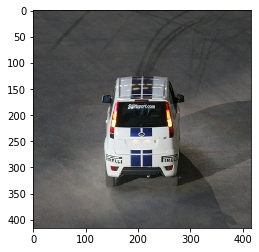

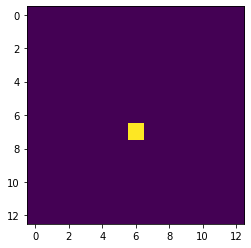

In [12]:
plt.imshow(sampleX[3])
plt.show()
img=sampleY[3][...,11+5]
plt.imshow(img)
plt.show()

index 0


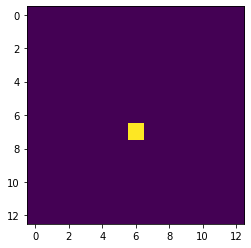

index 1


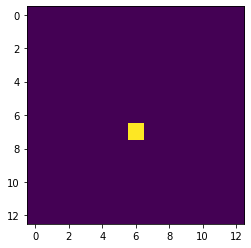

index 2


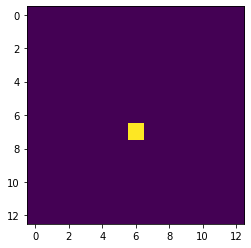

index 3


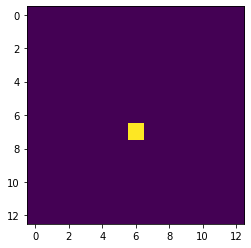

index 4


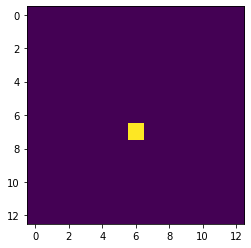

index 5


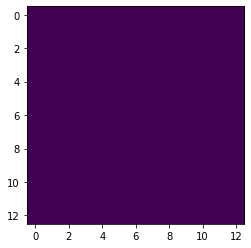

index 6


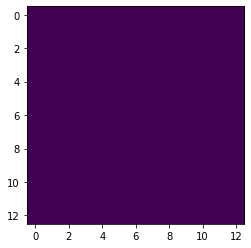

index 7


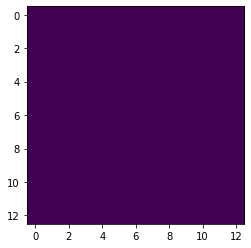

index 8


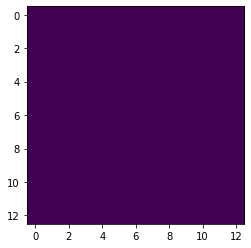

index 9


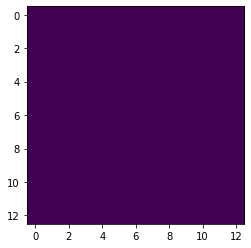

index 10


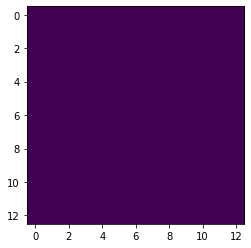

index 11


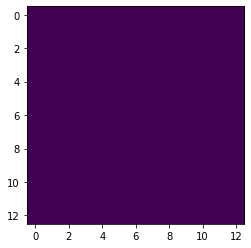

index 12


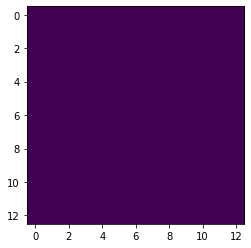

index 13


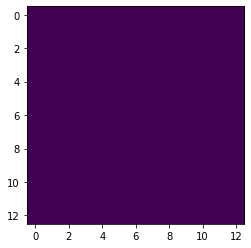

index 14


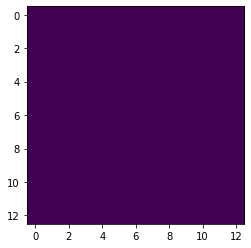

index 15


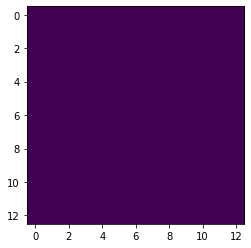

index 16


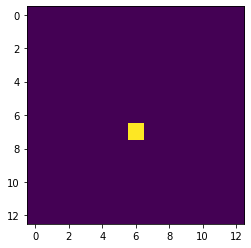

index 17


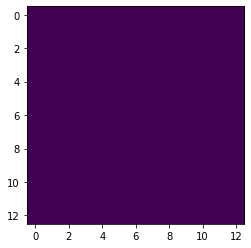

index 18


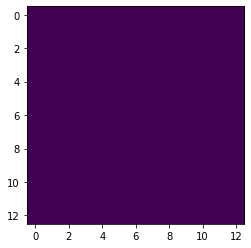

index 19


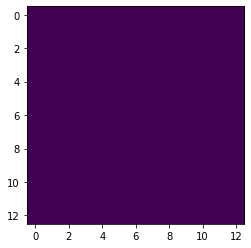

index 20


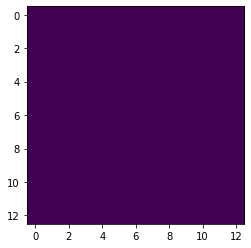

index 21


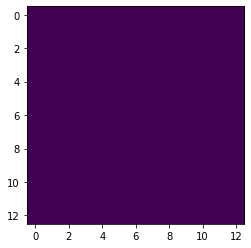

index 22


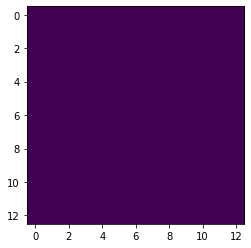

index 23


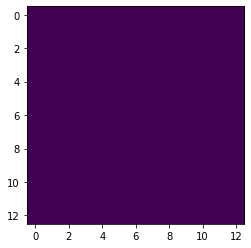

index 24


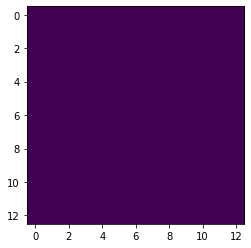

In [13]:
for i in range(0,25):
    print('index',i)
    plt.imshow(sampleY[3][...,i]*10)
    plt.show()

Epoch 1/40
401/401 [==============================] - 53s 132ms/step - loss: 973.2180 - acc: 0.0525 - val_loss: 344.2416 - val_acc: 0.0454
Epoch 2/40
401/401 [==============================] - 50s 125ms/step - loss: 247.0822 - acc: 0.0325 - val_loss: 224.2881 - val_acc: 0.0352
Epoch 3/40
401/401 [==============================] - 50s 125ms/step - loss: 166.0199 - acc: 0.0253 - val_loss: 176.4777 - val_acc: 0.0288
Epoch 4/40
401/401 [==============================] - 50s 126ms/step - loss: 130.1611 - acc: 0.0217 - val_loss: 151.2751 - val_acc: 0.0250
Epoch 5/40
401/401 [==============================] - 51s 126ms/step - loss: 108.4447 - acc: 0.0195 - val_loss: 135.6829 - val_acc: 0.0224
Epoch 6/40
401/401 [==============================] - 51s 127ms/step - loss: 93.3237 - acc: 0.0178 - val_loss: 125.0781 - val_acc: 0.0203
Epoch 7/40
401/401 [==============================] - 51s 126ms/step - loss: 81.8809 - acc: 0.0165 - val_loss: 117.4080 - val_acc: 0.0188
Epoch 8/40
401/401 [=========

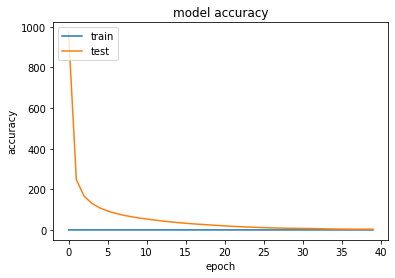

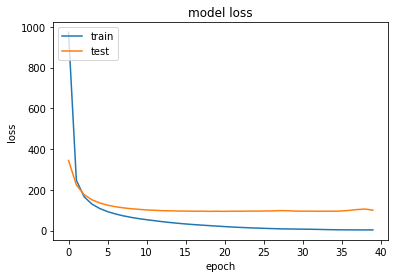

In [14]:
if train==True:
    model=load_weights(model,path_wts)
    for layer in model.layers[:-5]:
        layer.trainable=False
    model=train_model(model)
if train==False:
    model.load_weights(path_wts_final)

### Predicion Block

110 227 138 294
(0.3326888657533206, 0.454908691919767, 0.4160758646634909, 0.5891105395096999, 0.8320654, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


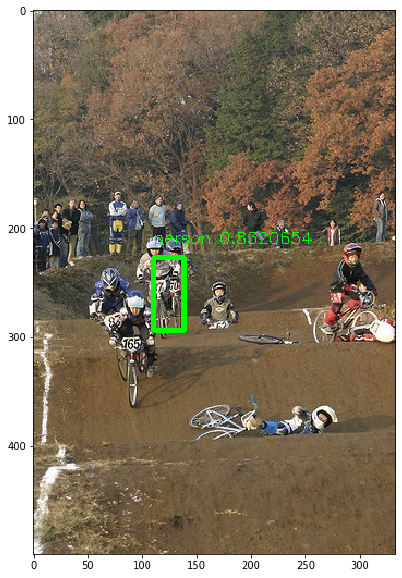

135406.15949334123
138 120 355 233
(0.2764284473199111, 0.3604133908565228, 0.7114849870021527, 0.6986446609863868, 0.78941953, 4)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


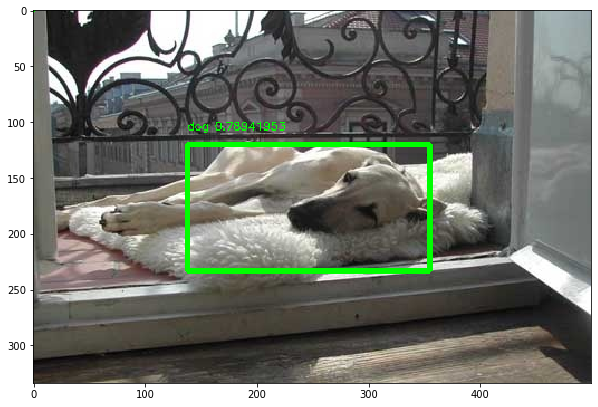

32975.73269472738
218 137 299 228
(0.4375653175207285, 0.36667059476558983, 0.5996805062660805, 0.6093388199806213, 0.8208037, 14)
287 142 385 223
(0.5753062092340909, 0.37887946229714614, 0.7703500665151156, 0.5952101189356584, 0.7885658, 15)
0 0 0 0
(0, 0, 0, 0, 0, 0)


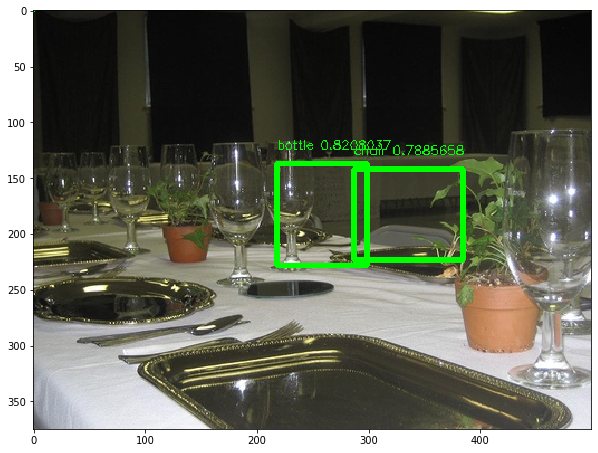

65677.80188510238
64 93 307 323
(0.1288766391002215, 0.24974963871332317, 0.6143091538777719, 0.8637372312637477, 0.82793486, 2)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


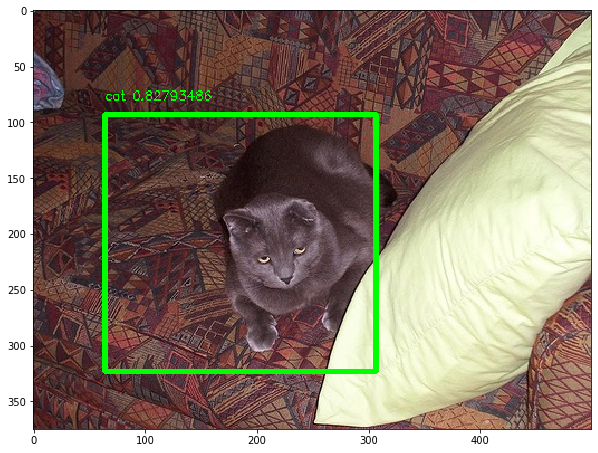

68374.24782401022
63 244 215 381
(0.188941634618319, 0.4881970607317412, 0.6440777870324942, 0.762171717790457, 0.9136328, 15)
60 172 92 212
(0.1808377871146569, 0.3449243032015287, 0.27831819424262416, 0.4259152045616737, 0.7092333, 19)
0 0 0 0
(0, 0, 0, 0, 0, 0)


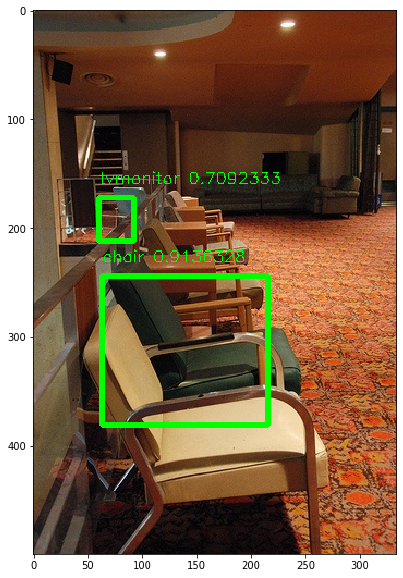

132169.24666841244
22 213 497 335
(0.04413680846874535, 0.5689415564903847, 0.9959409695405227, 0.8949195788456844, 0.8338823, 13)
189 264 351 336
(0.3797936210265527, 0.7056871033631839, 0.7039074301719666, 0.8966155258508829, 0.78911275, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


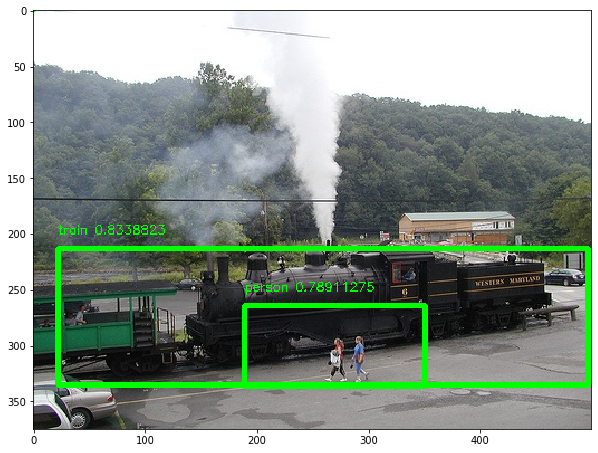

326432.1606809336
112 102 296 199
(0.22454518079757693, 0.3070607139514043, 0.593205594099485, 0.5983003790561969, 0.7580886, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


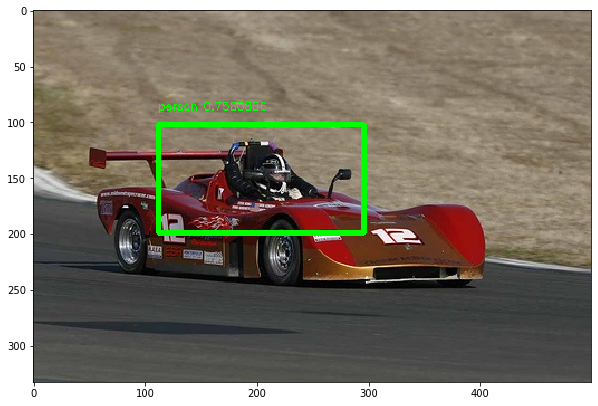

76508.41908394558
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


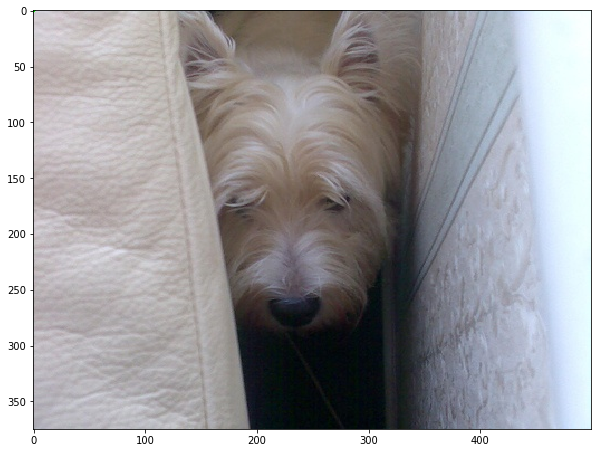

194115
69 132 237 286
(0.13927075395790428, 0.3546033180676974, 0.47577906471605486, 0.7650240659713746, 0.84270185, 11)
198 135 254 193
(0.3977989273575636, 0.3606438499230605, 0.5088068837156663, 0.5158850092154282, 0.70790595, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


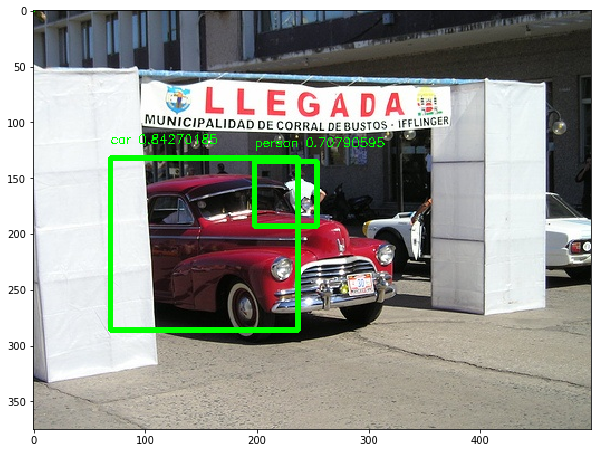

46270.28598808753
148 71 322 308
(0.29799314187123227, 0.214353105196586, 0.6442146255419805, 0.9276119218422817, 0.7122502, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


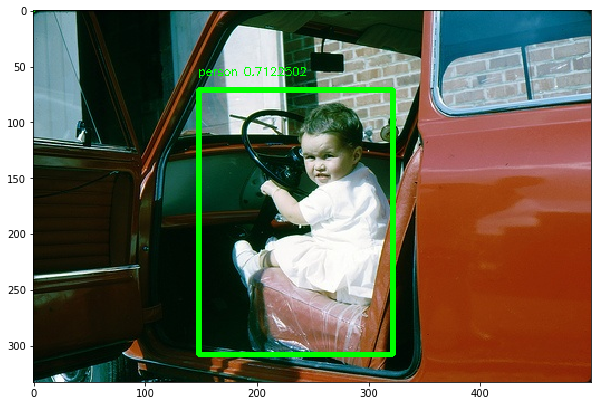

43583.553500651884
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


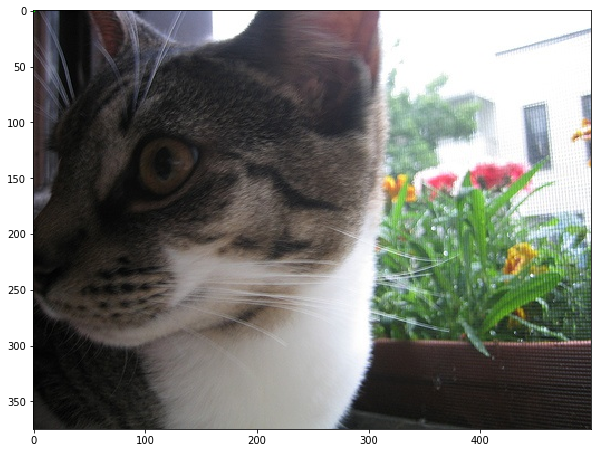

298231
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


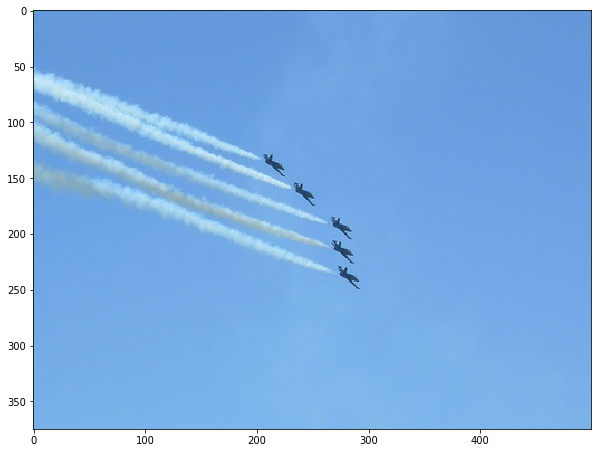

57003
246 91 362 157
(0.492184354708745, 0.45495393643012416, 0.7249593643041758, 0.7797451844582192, 0.7313782, 3)
458 45 458 70
(0.9177312799371207, 0.22530198097229004, 0.9165878656965036, 0.3501571783652673, 0.72963107, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


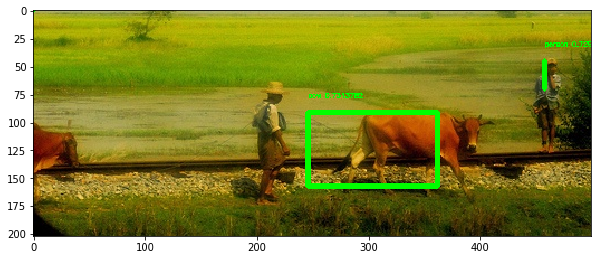

72975.07832840932
38 132 136 235
(0.07749544657193698, 0.4018822335279906, 0.27398953071007365, 0.7158656372473791, 0.8300595, 9)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


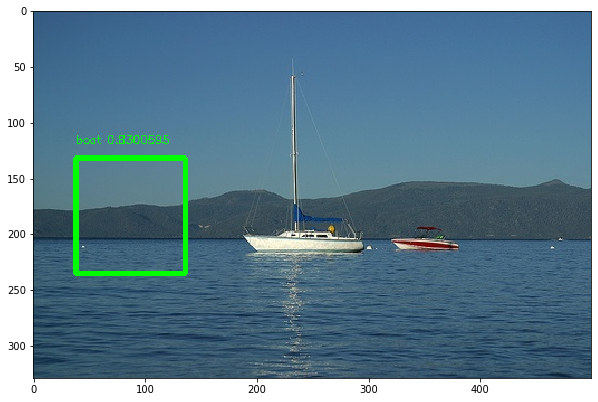

34560.13696007796
54 81 221 363
(0.10946209614093491, 0.21720991226343012, 0.4437565986926739, 0.9720865625601549, 0.8586721, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


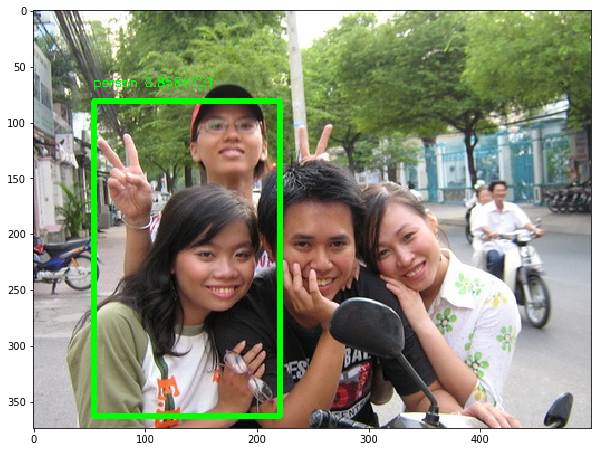

61152.61411289248
104 47 381 320
(0.20897526465929472, 0.12608950871687669, 0.7626608931101286, 0.8544338391377375, 0.9377211, 0)
156 64 255 218
(0.31393830592815697, 0.17327843033350432, 0.5117547878852258, 0.58377693937375, 0.8012319, 19)
217 26 337 123
(0.43511995100058043, 0.06945556402206421, 0.6751562735209099, 0.32936115906788754, 0.71761376, 8)


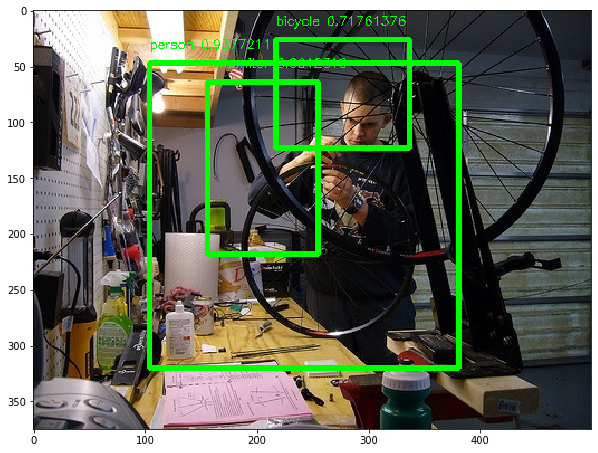

304233.1551581342
12 43 440 374
(0.024915388570382058, 0.115918605373456, 0.8804733437987475, 0.9988222179504542, 0.897128, 1)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


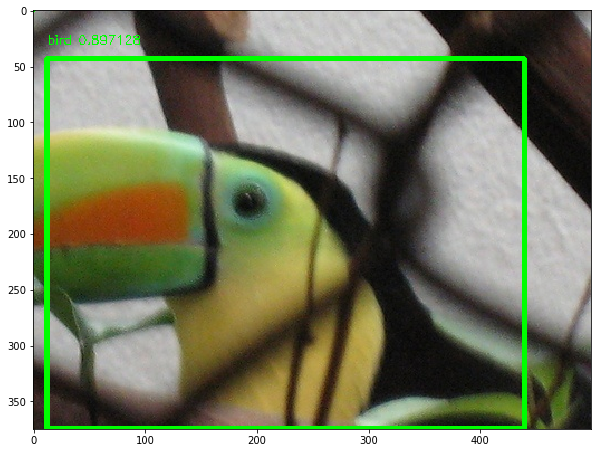

99332.41201081303
297 269 442 329
(0.5957866173524123, 0.8105439360325153, 0.8843473012630757, 0.9882216774500334, 0.80068976, 15)
354 52 464 230
(0.7090214628439684, 0.15828717213410598, 0.9299345795924847, 0.6918326662136958, 0.80015886, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


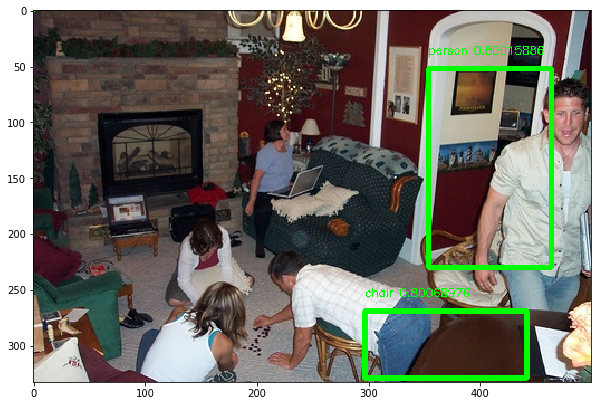

198622.7580578213
430 140 485 274
(0.8603678305561726, 0.37529884851895845, 0.9709991864286938, 0.7318872855259823, 0.8442014, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


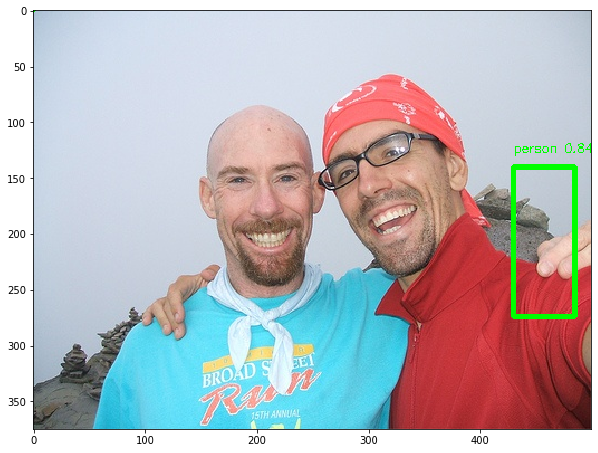

75015.83817373337
45 60 419 352
(0.09046528889582711, 0.16226545778604656, 0.8393679765554576, 0.9401646863955719, 0.8744649, 0)
26 216 104 309
(0.0523555943599114, 0.5765419894686112, 0.20841174171521115, 0.826151514855715, 0.6929256, 14)
0 0 0 0
(0, 0, 0, 0, 0, 0)


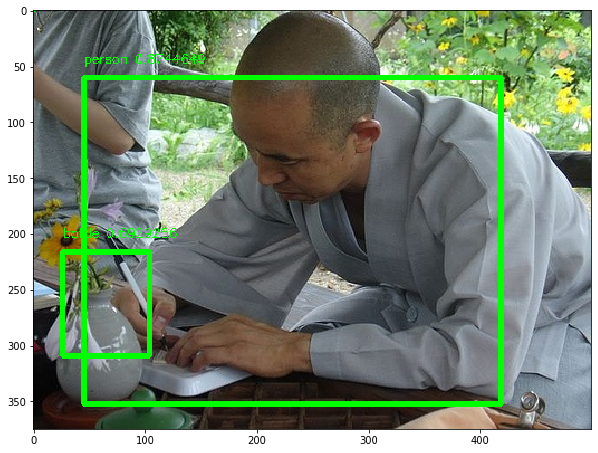

59594.09259194264
392 159 433 217
(0.7855940415309026, 0.4247611669393686, 0.8664530699069684, 0.5810523766737717, 0.78673667, 19)
313 248 396 302
(0.6272624593514663, 0.663643465592311, 0.792279403943282, 0.8071561822524439, 0.7862357, 15)
0 0 0 0
(0, 0, 0, 0, 0, 0)


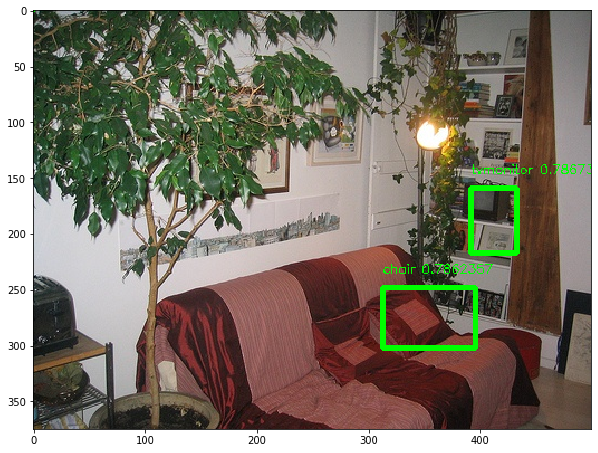

38323.482677503736
232 25 490 129
(0.4659086099037757, 0.07250719345532933, 0.9819137224784265, 0.36825346488219046, 0.87240386, 11)
233 89 354 159
(0.4674915487949665, 0.2533927468153147, 0.7092469242902903, 0.45109322896370524, 0.7034668, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


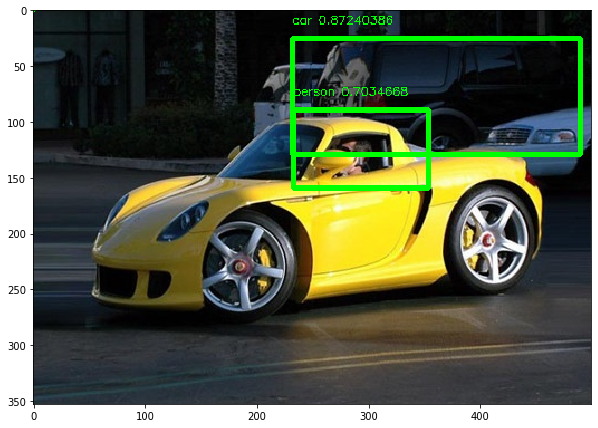

131722.7135094134
239 30 397 300
(0.4795916355573214, 0.09105287606899559, 0.7942411807867197, 0.9038673685147213, 0.8298359, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


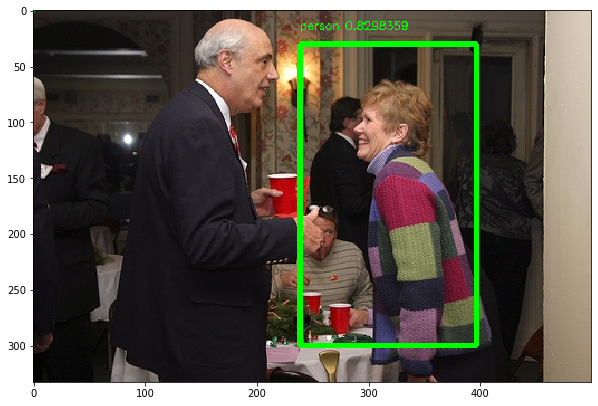

66534.71667298544
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


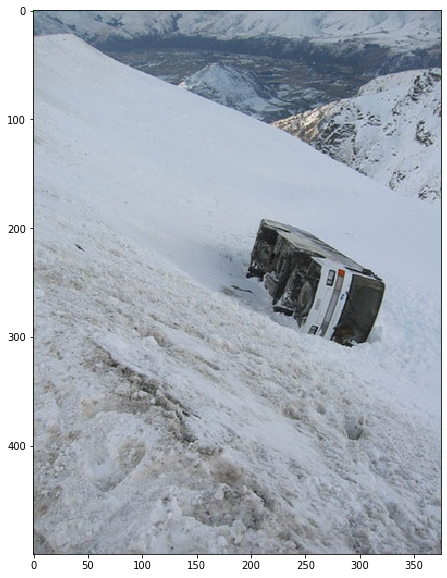

156548
11 49 385 371
(0.02200789978870976, 0.13150543203720677, 0.770630500637568, 0.9893355530041915, 0.8530945, 3)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


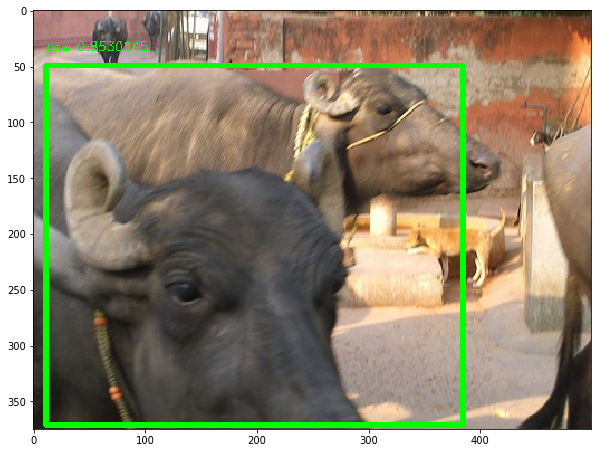

275914.53922915
210 1 319 169
(0.4203137061916865, 0.006028560491708634, 0.6380056595573059, 0.513063485805805, 0.7979676, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


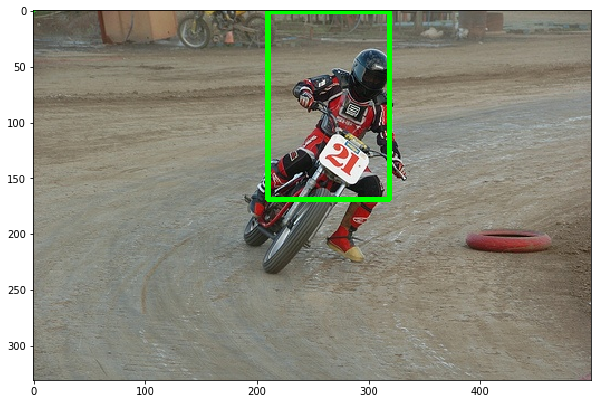

60883.79848096976
230 99 425 337
(0.46147833420680123, 0.26429439049500686, 0.8517782779840324, 0.8988240911410406, 0.7832824, 15)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


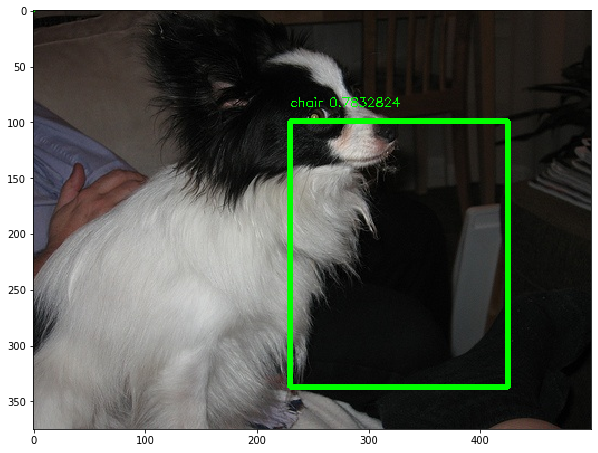

21033.04633240552
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


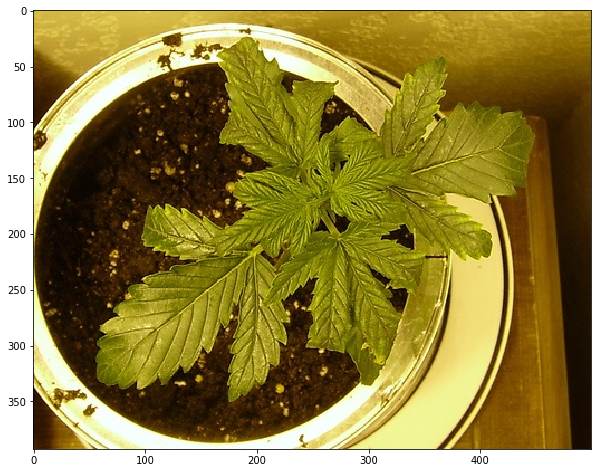

370895
80 159 421 327
(0.16182313286341155, 0.4797670795367314, 0.8432950308689705, 0.982211933686183, 0.8312816, 1)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


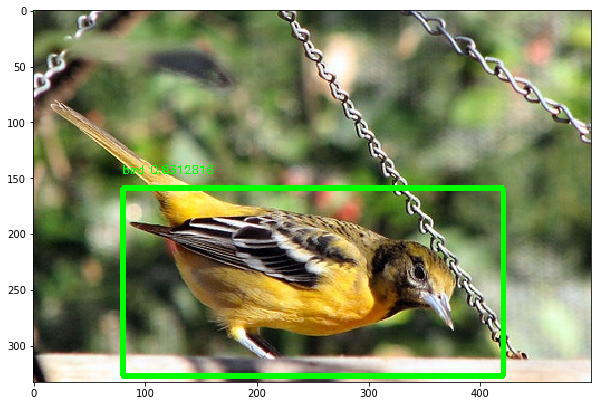

28921.05126478753
123 105 329 306
(0.2573904624352088, 0.3314160291965192, 0.6854629883399377, 0.9635920616296623, 0.88738984, 5)
116 46 269 297
(0.24330963079745951, 0.1476765045752892, 0.5605832109084496, 0.935827218569242, 0.7944628, 0)
367 139 462 274
(0.7662724657700613, 0.4390683334607345, 0.9628889136589491, 0.861661046743393, 0.7025386, 11)


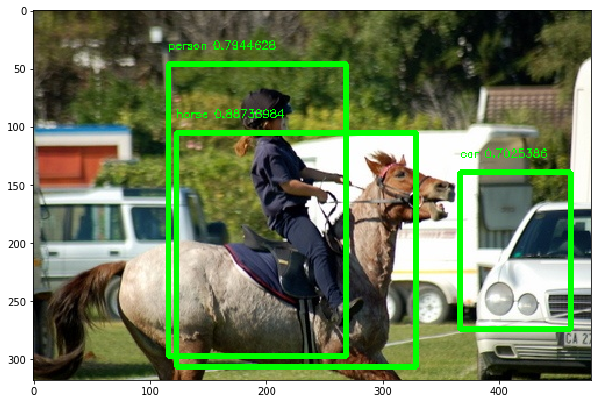

46781.85220389026
95 128 319 272
(0.19171122633493864, 0.3438567106540386, 0.639146421964352, 0.7265644531983595, 0.81969, 10)
35 173 89 371
(0.07038416312291071, 0.4616924707706158, 0.17935023857997015, 0.9919223326903124, 0.7651718, 0)
428 132 486 168
(0.8573519725065964, 0.3533239708496974, 0.9731709406926082, 0.4497261207837325, 0.75097847, 15)


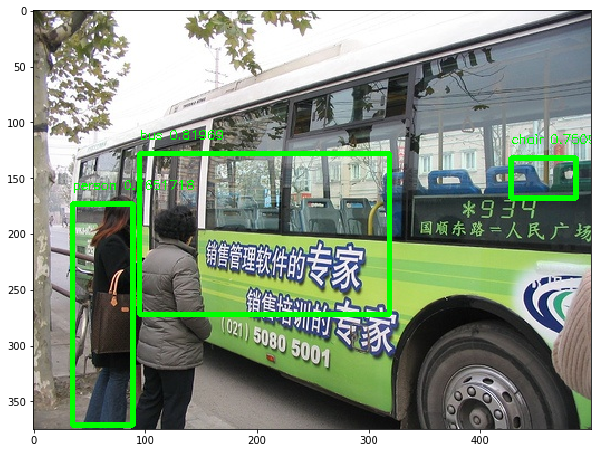

51632.762553178734
234 152 398 222
(0.4686913249584345, 0.40616498772914594, 0.7977808564901352, 0.5926906810357021, 0.7558648, 0)
62 43 218 218
(0.12476662947581366, 0.11693973266161406, 0.43643154089267444, 0.583213040461907, 0.7285772, 7)
0 0 0 0
(0, 0, 0, 0, 0, 0)


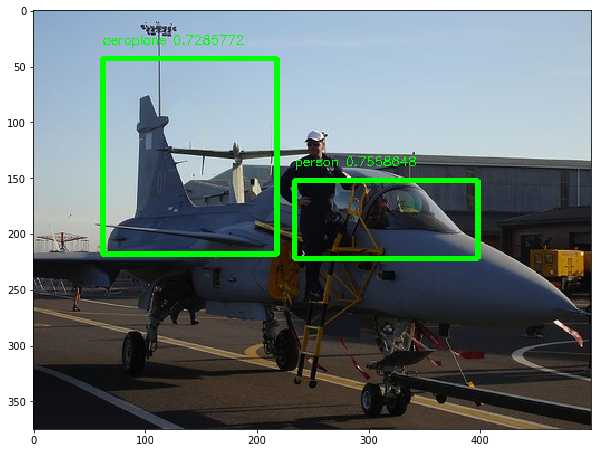

16941.03627352046
1 114 182 333
(0.003102783973400386, 0.30448131836377657, 0.3648806764529302, 0.8881369691628677, 0.84061736, 0)
157 66 470 275
(0.31417877742877376, 0.17734141991688657, 0.9413701009291869, 0.7346928990804232, 0.83543766, 10)
0 0 0 0
(0, 0, 0, 0, 0, 0)


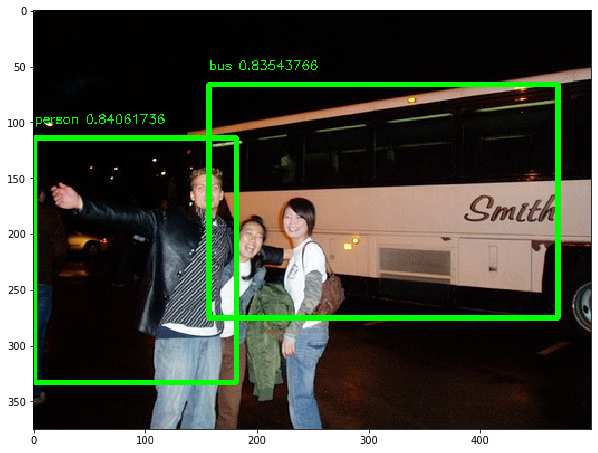

105840.3917744197
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


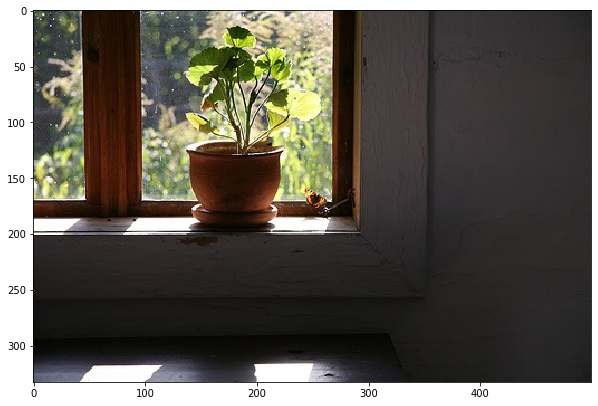

105154
146 88 480 315
(0.2925164481768241, 0.2351529689935538, 0.9616444259881973, 0.8424967894187341, 0.8038274, 11)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


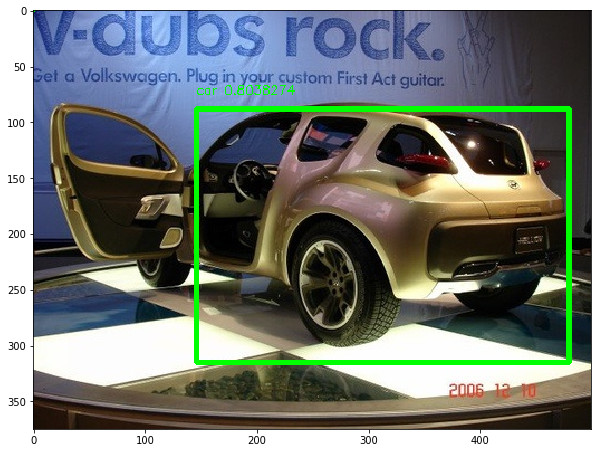

31791.650256889523
51 81 319 286
(0.10361033104933226, 0.2439103298462354, 0.639393768631495, 0.8605807182880548, 0.74023646, 1)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


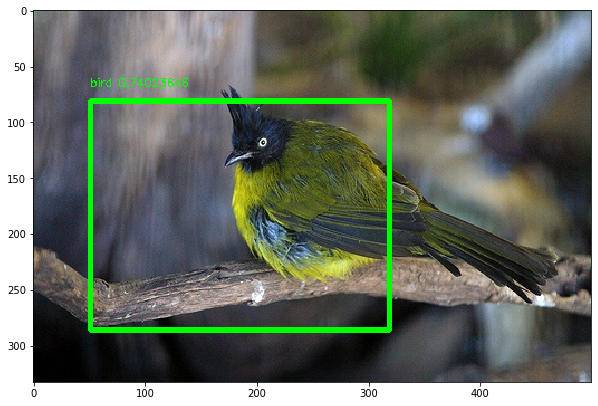

72832.16727395216
178 54 327 245
(0.3566795449990493, 0.15480017203551077, 0.6550540144626912, 0.6981019744506249, 0.6707138, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


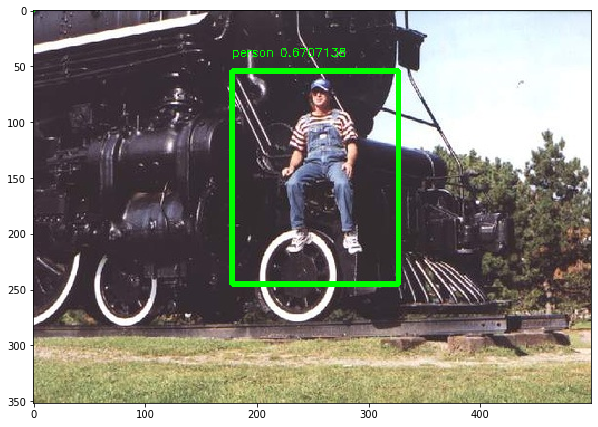

20482.919062999248
44 154 82 237
(0.08955202652857855, 0.4651308151391837, 0.16575568455916187, 0.7120789839671209, 0.8216162, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


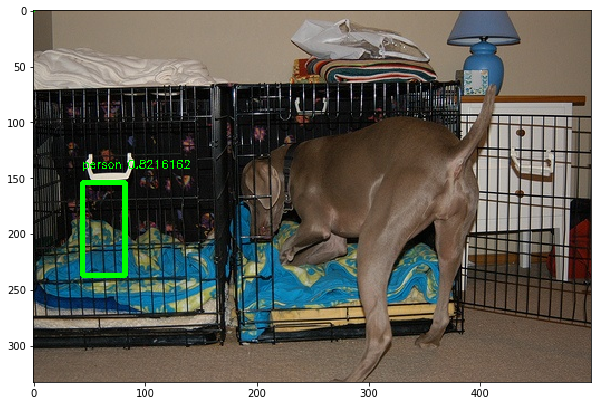

66174.5590144862
140 65 389 211
(0.2818888059029212, 0.19606009584206802, 0.7787393698325524, 0.6339965485609496, 0.7500137, 11)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


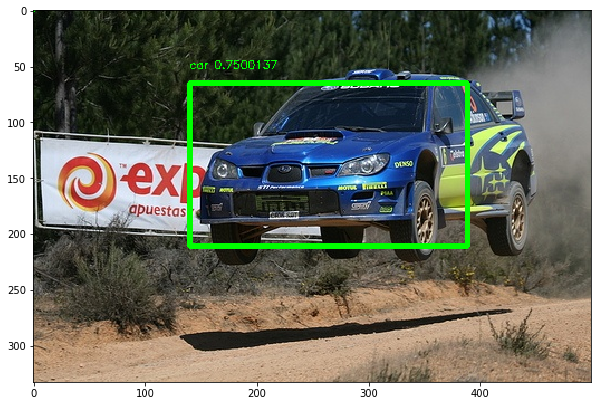

32432.373235974334
78 150 119 311
(0.15658046649052548, 0.3771820297608009, 0.2389048429635855, 0.7819322668589079, 0.8672837, 0)
134 184 206 356
(0.26932596701842093, 0.46349387443982637, 0.4134710614497845, 0.8925028718434848, 0.81297004, 5)
0 0 0 0
(0, 0, 0, 0, 0, 0)


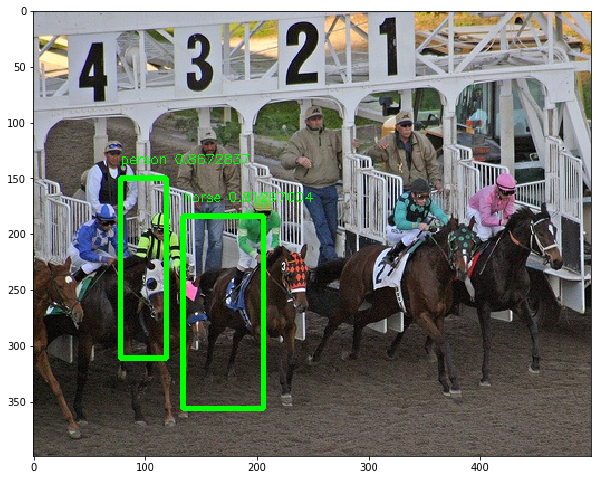

57322.37604052902
38 138 496 358
(0.07754307412184208, 0.3699864470041715, 0.9935523901994412, 0.9572856472088741, 0.8859246, 18)
95 254 110 342
(0.19001276676471418, 0.6786949680401729, 0.22043251074277437, 0.9137353392747732, 0.88196135, 14)
46 38 197 285
(0.09256869669143969, 0.10387487594897932, 0.39510855881067425, 0.7615795960793128, 0.7202538, 0)


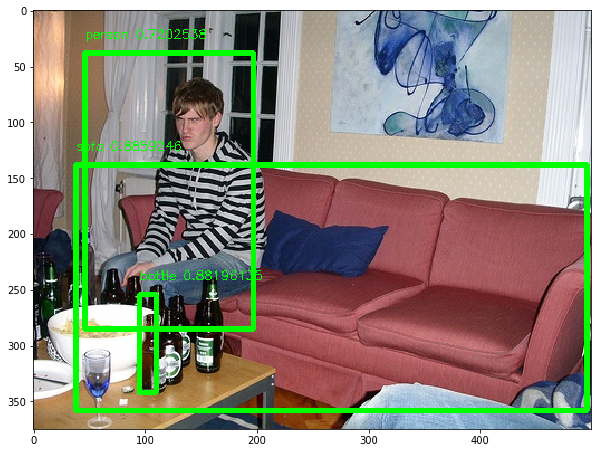

83750.148742751
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


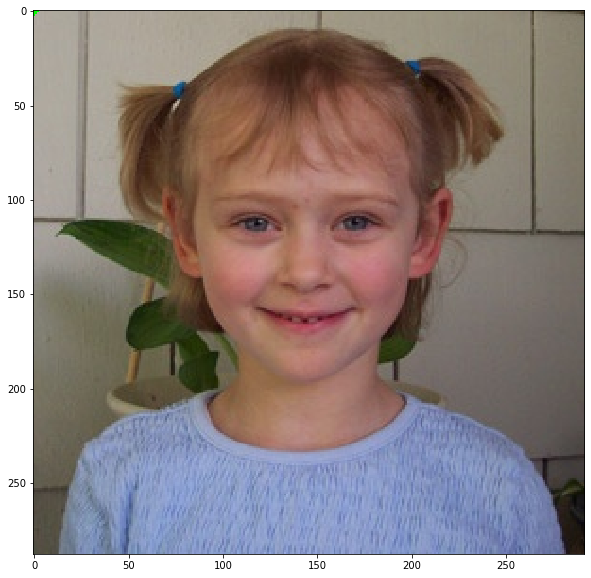

192485
273 196 411 254
(0.5478893839395964, 0.5862388610839844, 0.8220623135566711, 0.7560503482818604, 0.76422775, 11)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


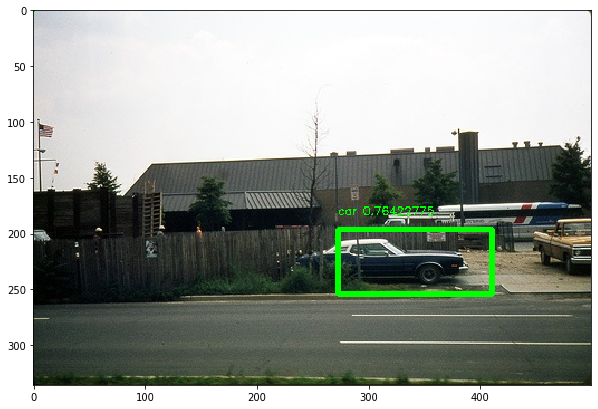

145751.05985118175
28 80 84 201
(0.08098377631260799, 0.3077071217390207, 0.24107974309187669, 0.7690380123945383, 0.83392596, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


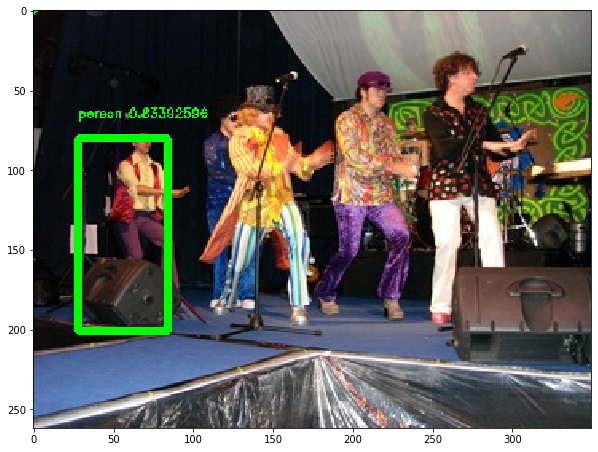

34192.61546791389
79 308 247 362
(0.15952715506920448, 0.8217576604623061, 0.49481109472421503, 0.96722156726397, 0.8537802, 0)
385 197 432 240
(0.771514681669382, 0.526265589090494, 0.86432133271144, 0.6419103008050185, 0.83917195, 1)
156 54 379 249
(0.3124293730809139, 0.14513386442111093, 0.7580284155332125, 0.6659677234979777, 0.83456844, 19)


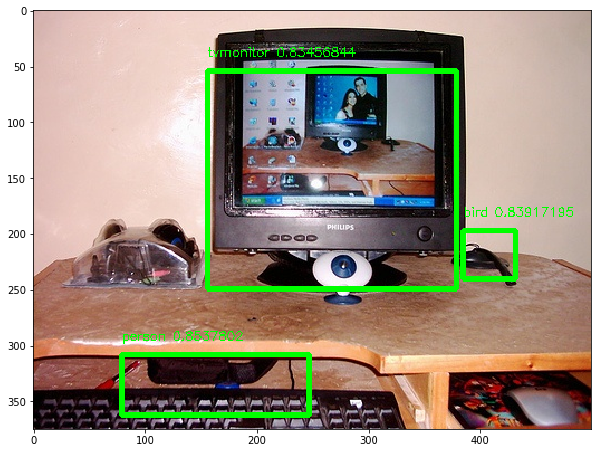

82402.36690416187
195 135 429 312
(0.3903035727831034, 0.3616451804454511, 0.8583708886916821, 0.8338581186074479, 0.70687854, 1)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


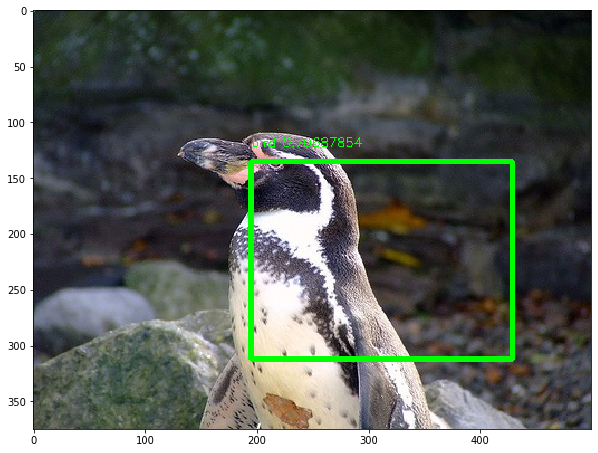

47198.94162405253
95 204 207 401
(0.3920288040087774, 0.40854192238587606, 0.8514786454347465, 0.8022056221961976, 0.8324132, 1)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


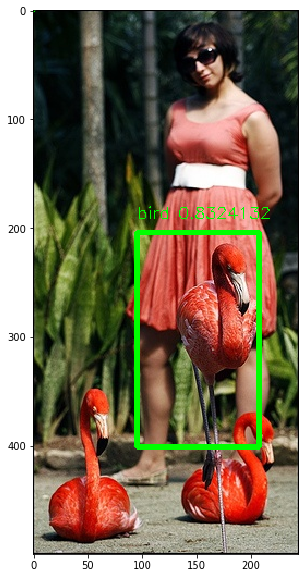

124636.28744097927
64 159 129 236
(0.1289163002601037, 0.4781415600043077, 0.2587072390776414, 0.7115904138638424, 0.792612, 11)
170 105 252 142
(0.3416014726345356, 0.3160775510164408, 0.5053535516445453, 0.426742991575828, 0.65018606, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


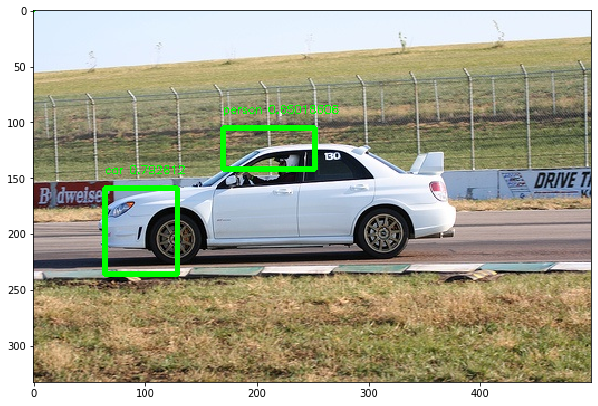

68081.25885015567
48 156 410 302
(0.09765479197868931, 0.4164119958877564, 0.8208993123127865, 0.8063354950684769, 0.6729578, 11)
0 0 0 0
(0, 0, 0, 0, 0, 0)
0 0 0 0
(0, 0, 0, 0, 0, 0)


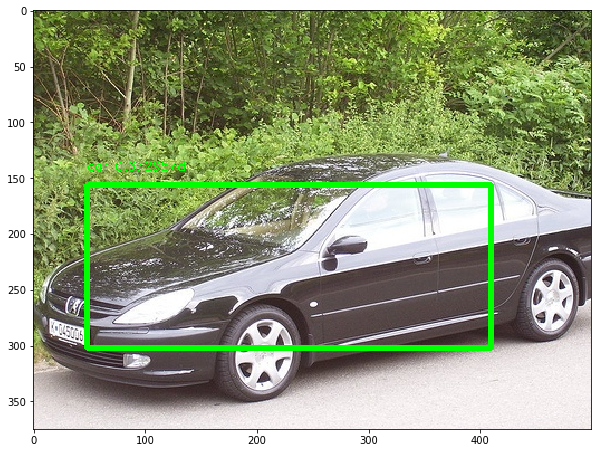

49240.61211125174
mean error 0.0


In [29]:
def _softmax(x, axis=-1, t=-100.):
    x = x - np.max(x)
    
    if np.min(x) < t:
        x = x/np.min(x)*t
        
    e_x = np.exp(x)
    
    return e_x / e_x.sum(axis, keepdims=True)

def _sigmoid(x):
    return 1. / (1. + np.exp(-x))

def decode_netout_anc(netout, anchors, nb_class, obj_threshold=0.3, nms_threshold=0.3):
    #grid_h, grid_w, nb_box = netout.shape[:3]
    grid_h, grid_w = netout.shape[:2]

    boxes = []
    
    # decode the output by the network
    netout[..., 4]  = _sigmoid(netout[..., 4])
    netout[..., 5:] = netout[..., 4][..., np.newaxis] * _softmax(netout[..., 5:])
    netout[..., 5:] *= netout[..., 5:] > obj_threshold
    
    for row in range(grid_h):
        for col in range(grid_w):
            for b in range(BOX):
                # from 4th element onwards are confidence and class classes
                classes = netout[row,col,b,5:]
                #classes = netout[row,col,5:]
                confidence = netout[row,col,b,4]
                if np.sum(classes) > 0:
                    # first 4 elements are x, y, w, and h
                    #x, y, w, h = netout[row,col,b,:4]
                    x, y, w, h = netout[row,col,b,:4]
                    #print(col,_sigmoid(x-col),row,_sigmoid(y),w,h)
                    x = (col + _sigmoid(x)) / grid_w # center position, unit: image width
                    y = (row + _sigmoid(y)) / grid_h # center position, unit: image height
                    w = ANCHORS[2 * b + 0] * np.exp(w) / grid_w # unit: image width
                    h = ANCHORS[2 * b + 1] * np.exp(h) / grid_h # unit: image height
                    #print(x,y,w,h)
                    classes=np.argmax(classes)
                    
                    box = (x-w/2, y-h/2, x+w/2, y+h/2, confidence, classes)
                    box = (x-w/2, y-h/2, x+w/2, y+h/2, confidence, classes)
                    if abs(box[0])<=1 and abs(box[1])<=1 and box[2]<=1 and box[3]<=1 :
                      if (box[0])>=0 and (box[1])>=0 and box[2]>=0 and box[3]>=0 :
                        boxes.append(box)
                    

                      
    indx=np.argsort([box[4] for box in boxes])
    f_boxes=[]
    #indx=reversed(indx)
    if len(indx)>=3:
      for i in range(1,2):
        ind=indx[-1*i]
        f_boxes.append(boxes[ind])
    else:
      f_boxes=boxes
    return f_boxes    
    
def decode_netout_1(netout, anchors, nb_class, obj_threshold=0.3, nms_threshold=0.3):
    #grid_h, grid_w, nb_box = netout.shape[:3]
    grid_h, grid_w = netout.shape[:2]

    boxes = []
    
    # decode the output by the network
    netout[..., 4]  = _sigmoid(netout[..., 4])
    netout[..., 5:] = netout[..., 4][..., np.newaxis] * _softmax(netout[..., 5:])
    netout[..., 5:] *= netout[..., 5:] > obj_threshold
    class_prob_log=[0]*CLASS
    boxes=[(0,)*6]*CLASS
    for row in range(grid_h):
        for col in range(grid_w):
            #for b in range(BOX):
                # from 4th element onwards are confidence and class classes
                classes = netout[row,col,5:]
                #classes = netout[row,col,5:]
                confidence = netout[row,col,4]
                if np.sum(classes) > 0:
                    # first 4 elements are x, y, w, and h
                    #x, y, w, h = netout[row,col,b,:4]
                    x, y, w, h = netout[row,col,:4]
                    #print(col,_sigmoid(x-col),row,_sigmoid(y),w,h)
                    w_ratio=(IMAGE_W/GRID_W)/IMAGE_W
                    h_ratio=(IMAGE_W/GRID_W)/IMAGE_H
                    x = (col+(x))*(h_ratio)#x*(32/416) # center position, unit: image width
                    y = (row+(y))*(w_ratio)#y*(32/416) # center position, unit: image height
                    w = w*(w_ratio) # unit: image width
                    h = h*(h_ratio) # unit: image height
                    #print(x,y,w,h)
                    class_ind=np.argmax(classes)
                    if class_prob_log[class_ind]< classes[class_ind]:       
                        class_prob_log[class_ind]=classes[class_ind]
                        box = (x-w/2, y-h/2, x+w/2, y+h/2, confidence, class_ind)
                        if abs(box[0])<=1 and abs(box[1])<=1 and box[2]<=1 and box[3]<=1 :
                              if (box[0])>=0 and (box[1])>=0 and box[2]>=0 and box[3]>=0 :
                                                    #boxes.append(box)
                                                    boxes[class_ind]=box

                      
    
    indx=np.argsort([box[4] for box in boxes])
    # remove the boxes which are less likely than a obj_threshold
    #obj_threshold=0
    #print(boxes)
    #for box in boxes:
    #  if box[4]>obj_threshold:
    #      obj_threshold=box[4]
    #boxes = [box for box in boxes if box[4] >= obj_threshold-0.1]
    f_boxes=[]
    #indx=reversed(indx)
    if len(indx)>=3:
      for i in range(1,4):
        ind=indx[-1*i]
        f_boxes.append(boxes[ind])
    else:
      f_boxes=boxes

    return f_boxes    

def draw_boxes_1(image, boxes, labels,t_lbl=None):
    image_h, image_w, _ = image.shape

    for box in boxes:
        xmin = int(box[0]*image_w)
        ymin = int(box[1]*image_h)
        xmax = int(box[2]*image_w)
        ymax = int(box[3]*image_h)
        x_off=20
        y_off=20
        print(xmin,ymin,xmax,ymax)
        print(box)
        #cv2.rectangle(image, (xmin-x_off,ymin-y_off), (xmax+x_off,ymax+y_off), (255,0,0), 3)
        cv2.rectangle(image, (xmin,ymin), (xmax,ymax), (0,255,0), 3)
        #if t_lbl !=None:
        #  cv2.rectangle(image, (t_lbl[0],t_lbl[1]), (t_lbl[2],t_lbl[3]), (0,0,255), 3)
        cv2.putText(image, 
                    labels[box[5]] + ' ' + str(box[4]), 
                    (xmin, ymin - 13), 
                    cv2.FONT_HERSHEY_SIMPLEX, 
                    1e-3 * image_h, 
                    (0,255,0), 1)
        
    return image

"""# Perform detection on image"""
error=0
count=0
import pandas as pd
#lbls=pd.read_csv(path_data+'/label.csv',names=[0,1,2,3,4,5])
  
for i in range(1,50):
  count+=1
  sample=valid_imgs[i]
  image = cv2.imread(sample['filename'])
  H_off=int(image.shape[0]*0.1)
  W_off=int(image.shape[1]*0.1)
  #image=image[H_off:-1*H_off,W_off:-1*W_off,:]
  dummy_array = np.zeros((1,1,1,1,TRUE_BOX_BUFFER,4))

  

  input_image = cv2.resize(image, (416, 416))
  input_image = input_image / 255.
  input_image = input_image[:,:,::-1]
  input_image = np.expand_dims(input_image, 0)

  netout = model.predict(input_image)
  #print(netout[0,:,:,0:2])


  if anc_box==True:
    boxes = decode_netout_anc(netout[0], 
                        obj_threshold=.60,
                        nms_threshold=.90,
                        anchors=ANCHORS, 
                        nb_class=CLASS)
  else:
    boxes = decode_netout_1(netout[0], 
                        obj_threshold=0.60,
                        nms_threshold=0.90,
                        anchors=ANCHORS, 
                        nb_class=CLASS)
  lbl=sample['object'][0]
  [xmin,ymin,xmax,ymax]=list(lbl.values())[1:]
  cx,cy=int(0.5*(xmax+xmin)),int(0.5*(ymax+ymin))
  iw,ih=int(xmax-xmin),int(ymax-ymin)
  true_lb=[cx,cy,iw,ih]
  err=np.sum(np.square(np.array(true_lb)-np.array(boxes[0][:4])*416))
  #if err<100:
  #  error+=err
  #else:
  #  error+=100
  #boxex.appned(true_lb)
  image = draw_boxes_1(image, boxes, LABELS,true_lb)
  plt.figure(figsize=(10,10))
  plt.imshow(image[:,:,::-1]); plt.show()
  print(err)
print('mean error',error/count)

In [16]:
boxes

[(0.17683927829448998,
  0.3434997888711783,
  0.9000837986285871,
  0.7334232880518987,
  0.6729578,
  11),
 (0, 0, 0, 0, 0, 0),
 (0, 0, 0, 0, 0, 0)]

In [17]:
[cx,cy,iw,ih]

[210, 265, 411, 250]

In [18]:
model.save('yolo_400.h5')

In [19]:
import pandas as pd
lbls=pd.read_csv(path_data+'/label.csv',names=[0,1,2,3,4,5])
true_lb=list(lbls.loc[0,0:5])
true_lb

NameError: name 'path_data' is not defined

In [ ]:
import numpy as np
import tensorflow as tf
label=np.ones((7,7,15))
label[...,14]=5
true_box=np.argmax(label[...,10:],-1)

In [ ]:
wts=np.ones((10))
wts[3:7]=9
res=tf.gather(wts,true_box)
sess=tf.Session()
ret=sess.run(res)
ret

In [ ]:
ret.shape

In [ ]:
label[...,4:].shape

In [ ]:
label[...,5:].shape

In [ ]:
label[...,5:].shape